## Introduction to Genetic Algorithms

### Evolutionary Algorithms
A type of machine learning that uses principles from nature to evolve a solution. Optimization is performed using evolutionary algorithms (EAs). The difference between traditional algorithms and EAs is that EAs are not static but dynamic as they can evolve over time.

The genetic algorithm is a random-based classical evolutionary algorithm. By random here we mean that in order to find a solution using the GA, random changes applied to the current solutions to generate new ones. Note that GA may be called Simple GA (SGA) due to its simplicity compared to other EAs. GA is based on Darwin’s theory of evolution. It is a slow gradual process that works by making changes to the making slight and slow changes. Also, GA makes slight changes to its solutions slowly until getting the best solution.

To summarize, the first step is to **generate a random population** of candidate solutions with each solution being a collection of data. The specifics of the representation of that data depends on the problem. After **defining an initial population** of randomly generated candidate solutions, the next step is to **evaluate the fitness** for each candidate in our population. That evaluation is specific to the particular problem we're trying to solve, but it always involves using the candidate data, and it always results in a numeric fitness score for each candidate. Based on those fitness scores we **select parent solutions** with generally higher fitness values, and then **crossover genetic information** from each to form child solutions. Those child solutions may undergo a **mutation**, and then the children form the next generation of the population. This process is repeated until after a certain number of generations that candidate with the best fitness is chosen as the ultimate solution to the problem.

![ga.png](imgs/ga.png)

One of the important ideas in evolutionary computing is the **solutions space**. The solution space is a set of all possible solutions to a given problem. **NP-hard** or **non-deterministic polynomial-time hardness** problems refers to a class of problems that are difficult to find a solution for. Non-deterministic means that for any given attempt to solve a problem, we may end up with a different solution due to a strong element of randomness in evolutionary computing. The polynomial-time part of it refers to measuring how long it takes to find a solution. **Combinatorial optimization** is a technique of finding an optimal combination of a given set of objects where an exhaustive search is not feasible. 

### Applications 
The genetic algorithm are effective in finding the optimal solutions, for example, finding an optimal subset of items to fit within a constrained area, optimally packing containers, resources allocation, shipping or dispatching, optimal ordering of data (where the number of possible permutations makes a brute-force approach impossible), optimal time manufacturing or scheduling. The genetic programming helps us in finding an equation to fit a set of data, to control a process, to control the movement of an object in space, to select stocks or investments, to generate keys for different types of cryptography, to create a strategy for picking a good starting hand for Texas Hold'em Poker, etc. 

### Generating a target string starting from a random string of the same length

In [1]:
import random
import datetime
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.image as mpimg
from matplotlib import animation
from IPython.display import HTML

import numpy as np
import pandas as pd

%matplotlib inline


In [2]:
# return a random string of the specified length
def generate_parent(length):
    genes = []
    while len(genes) < length:
        sampleSize = min(length - len(genes), len(geneSet))
        genes.extend(random.sample(geneSet, sampleSize))
    return ''.join(genes)

# returns the fitness score of the guessed string
def get_fitness(guess):
    return sum(1 for expected, actual in zip(target, guess) if expected == actual)

# Changing a character in the parent string at random index 
def mutate(parent):
    index = random.randrange(0, len(parent))
    childGenes = list(parent)
    newGene, alternate = random.sample(geneSet, 2)
    childGenes[index] = alternate if newGene == childGenes[index] else newGene
    return ''.join(childGenes)

def display(guess,startTime):
    timeDiff = (datetime.datetime.now() - startTime).microseconds
    fitness = get_fitness(guess)
    print("Guess: {}\tFitness Score: {}\tTime Taken (µs): {}".format(guess, fitness, timeDiff))

In [3]:
def predict_output(geneSet,target):
    
    all_childs=[] # List for storing all childs (used for plotting)

    # Initial Run
    startTime = datetime.datetime.now()
    bestParent = generate_parent(len(target))
    bestFitness = get_fitness(bestParent)
    display(bestParent,startTime)

    # Stopping when the guess matches result
    i=0 # Counting total iterations
    while True:
        i+=1
        child = mutate(bestParent)
        childFitness = get_fitness(child)
        
        all_childs.append(child)
        if bestFitness >= childFitness:
            continue
        display(child,startTime)
        
        if childFitness >= len(bestParent):
            break
        bestFitness = childFitness
        bestParent = child

    possibilities=len(set(geneSet))**len(target)

    print(f'\nTotal Possibilities: {possibilities}')
    print(f'Total iterations: {i}')
    print(f'Optimization over large space state: {round(((possibilities-i)/possibilities)*100,2)}%')
    
    return all_childs

In [4]:
def gengraph(possibilities,child,target,count):
          
#     for count,child in enumerate(child_list):
    gc=0 # Green Counter
    fig,ax=plt.subplots(1,1,figsize=(15,6))

    # Getting colors for arrows
    colors=[]
    for i, (expected,actual) in enumerate(list(zip(target, child))):
        if expected == actual:
            colors.append('green')
        else:
            colors.append('blue')    

    arrows=[]

    # Getting spaces between individual characters
    geneSet_spacing=np.linspace(0.1,0.9,len(possibilities))
    child_spacing=np.linspace(0.3,0.7,len(child))

    # Printing all characters
    for i,x in enumerate(geneSet_spacing):
        plt.text(x-0.005,0.8,possibilities[i],fontsize=12)

    # Printing Underscores
    for i,x in enumerate(child_spacing):
        plt.text(x,0.25,'_',fontsize=15)

    # Printing Child Characters    
    for i,x in enumerate(child_spacing):
        plt.text(x,0.26,child[i],fontsize=15)

    # Dictionary with keys as characters and values as spacing (for getting x-coordinates to define arrows)
    xpos=dict(zip(possibilities,geneSet_spacing))

    # Defining arrows for every character of child
    for i,x in enumerate(child):
        if colors[i]=='green':
            gc+=1 
            alpha,color=0.3,'green'
        else:
            alpha,color=0.1, 'blue'
        arrows.append(patches.Arrow(xpos[x],0.8,child_spacing[i]-xpos[x],-0.5,width=0.01,alpha=alpha,color=color))

    for p in arrows:
        ax.add_patch(p)


    plt.text(0.9,0.65,f"Fitness Score: {gc}",fontsize=13)
    plt.text(0.9,0.50,f"Total iterations: {count}",fontsize=13)
    plt.text(0.9,0.35,f"Current Guess: {child}",fontsize=13)

    plt.axis(False)
    plt.savefig(f'anim/{count}_{child}.png')
    plt.close()
    

In [5]:
# geneSet = "01"
# target = "1111111111"

# test= predict_output(geneSet,target)

In [82]:
geneSet = "aAbBcCdDeEfFgGhHiIjJkKlLmM nNoOpPqQrRsStTuUvVwWxXyYzZ"
target = "HPC Project"

test= predict_output(geneSet,target)

Guess: DHYIpvzRhfj	Fitness Score: 0	Time Taken (µs): 0
Guess: DHCIpvzRhfj	Fitness Score: 1	Time Taken (µs): 0
Guess: DPCIpvzRhfj	Fitness Score: 2	Time Taken (µs): 0
Guess: HPCIpvzRhfj	Fitness Score: 3	Time Taken (µs): 4508
Guess: HPCIpvoRhfj	Fitness Score: 4	Time Taken (µs): 4508
Guess: HPCIPvoRhfj	Fitness Score: 5	Time Taken (µs): 4508
Guess: HPCIPvojhfj	Fitness Score: 6	Time Taken (µs): 4508
Guess: HPCIPvojhft	Fitness Score: 7	Time Taken (µs): 4508
Guess: HPCIPvojeft	Fitness Score: 8	Time Taken (µs): 5506
Guess: HPC Pvojeft	Fitness Score: 9	Time Taken (µs): 5506
Guess: HPC Pvoject	Fitness Score: 10	Time Taken (µs): 5506
Guess: HPC Project	Fitness Score: 11	Time Taken (µs): 5506

Total Possibilities: 9269035929372191597
Total iterations: 641
Optimization over large space state: 100.0%


In [83]:
len(test)

641

In [84]:
def generate_images(possibilities,child_list,target):
    for count,child in enumerate(child_list):
        gengraph(possibilities,child,target,count)
#         print(count,child)

In [85]:
generate_images(possibilities=geneSet,child_list=test,target=target)

In [ ]:
# import threading

# threads = 4
# jobs = []
# for i in range(0, threads):
#     thread = threading.Thread(target=generate_images(possibilities=geneSet,child_list=test,target=target))
#     jobs.append(thread)
    
# for j in jobs:
#     j.start()

# for j in jobs:
#     j.join()

In [ ]:
# gengraph(possibilities=geneSet,child_list=test,target=target)

In [86]:
imgs=[]
for i,each in enumerate(test):
    imgs.append(mpimg.imread(f'anim/{i}_{each}.png'))
len(imgs)

641

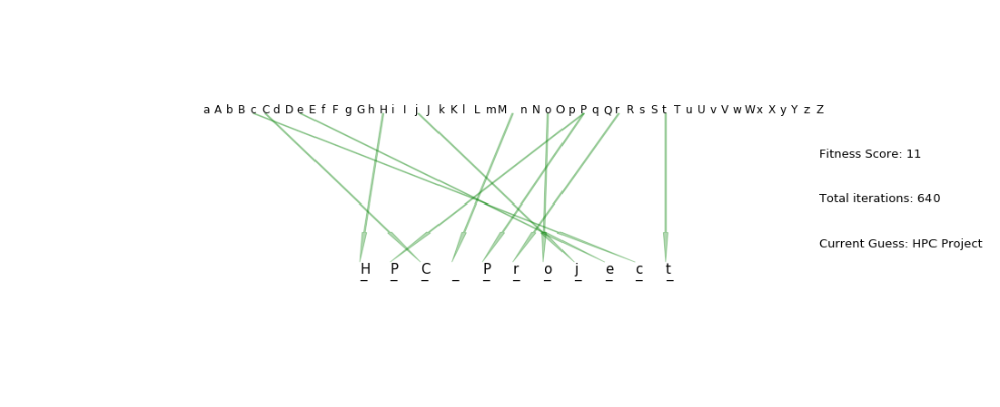

In [87]:
def plot_images(img_list):
    def init():
        img.set_data(img_list[0])
        return (img,)

    def animate(i):
        img.set_data(img_list[i])
        return (img,)

    fig = plt.figure(figsize=(20,8))
    ax = fig.gca()
    img = ax.imshow(img_list[0])
    plt.axis('off')
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                 frames=len(img_list), interval=50, blit=True)
    return anim


In [ ]:
HTML(plot_images(imgs).to_html5_video())

Animation size has reached 21001645 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


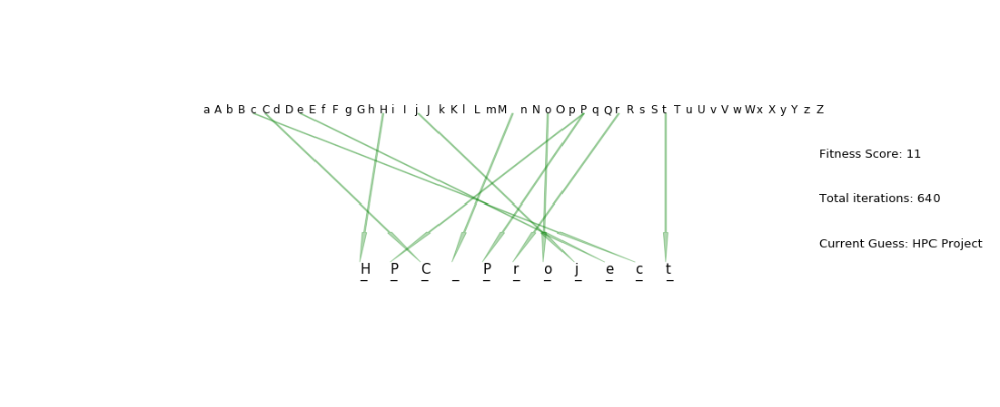

In [88]:
HTML(plot_images(imgs).to_jshtml())

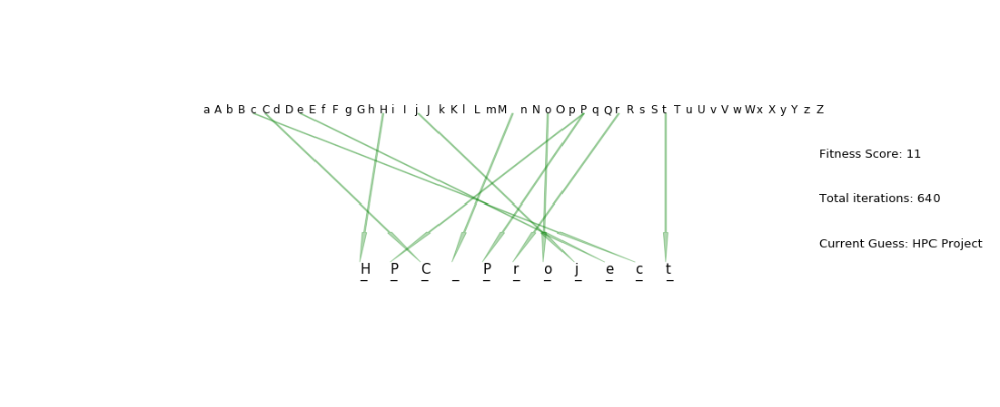

In [89]:
plot_images(imgs).save('test.mp4');